In [14]:
from photutils.segmentation import make_source_mask

In [4]:
from astropy.io import fits
import os, glob

In [154]:
file = '/data2/CLASS/astronomicalobservation/Combined_images/M87-i.fits'

In [155]:
from astropy.visualization import simple_norm

In [156]:
data_raw = fits.getdata(file)

In [157]:
norm = simple_norm(data_raw, 'log')

In [158]:
import matplotlib.pyplot as plt

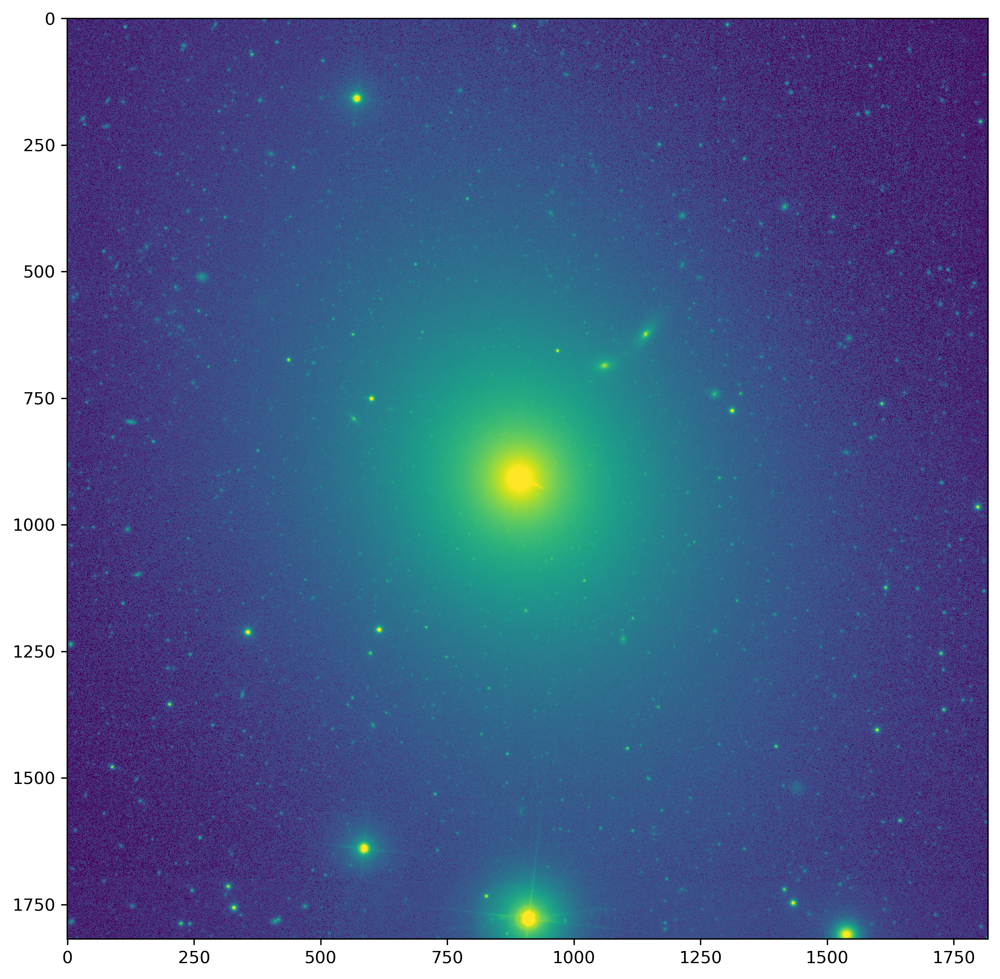

In [159]:
plt.figure(figsize = (10,10), dpi = 300)
plt.imshow(data_raw*10, norm = norm)

In [160]:
import numpy as np

In [161]:
# For g-band image of M105
imgname = "/data2/CLASS/astronomicalobservation/Combined_images/M87-g.fits"
x_center, y_center = 893.0, 909.0    # depending on your object & image size
r0 = 800.0    # outer boundary for sky estimation (up to you)

# --- Background estimation for determining backgroun level --- #
### (This is up to you! You do not have to do this if the background level in your images can be obviously determined.)
img = fits.getdata(imgname, ext=0)

x1d = np.arange(0, img.shape[1], 1)
y1d = np.arange(0, img.shape[0], 1)
xx, yy = np.meshgrid(x1d, y1d, sparse=True)
z = ((xx-x_center)**2.0 + (yy-y_center)**2.0 - r0**2.0)
sky_region = (z > 0.0)

In [162]:
data_m1 =np.ma.array(data_raw, mask = ~sky_region)

In [163]:
norm = simple_norm(data_m1[sky_region], 'log')

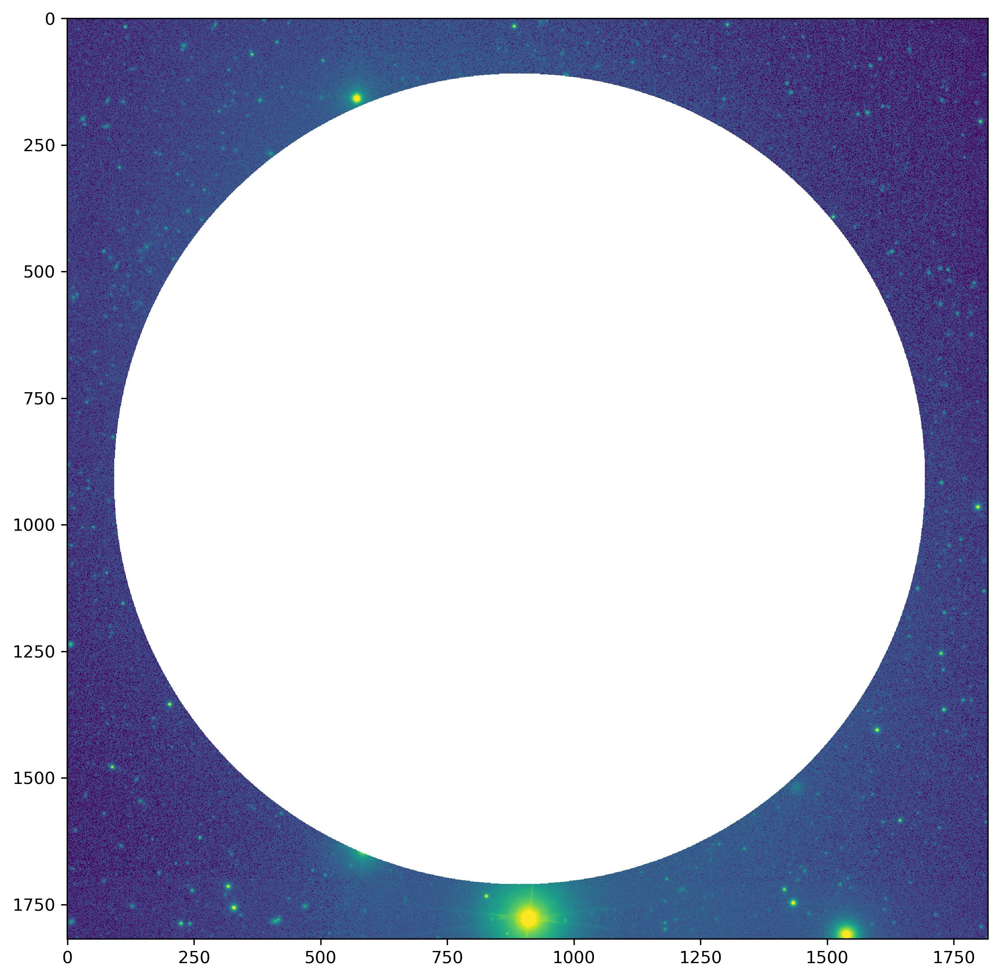

In [164]:
plt.figure(figsize = (10,10), dpi = 300)
plt.imshow(data_m1*10, norm = norm )

In [165]:
sourcemask = make_source_mask(data_m1, nsigma = 3, npixels = 3, dilate_size= 11)

In [166]:
data_m2 = np.ma.array(data_m1, mask = sourcemask)

In [167]:

norm = simple_norm(data_m2[sky_region], 'log')


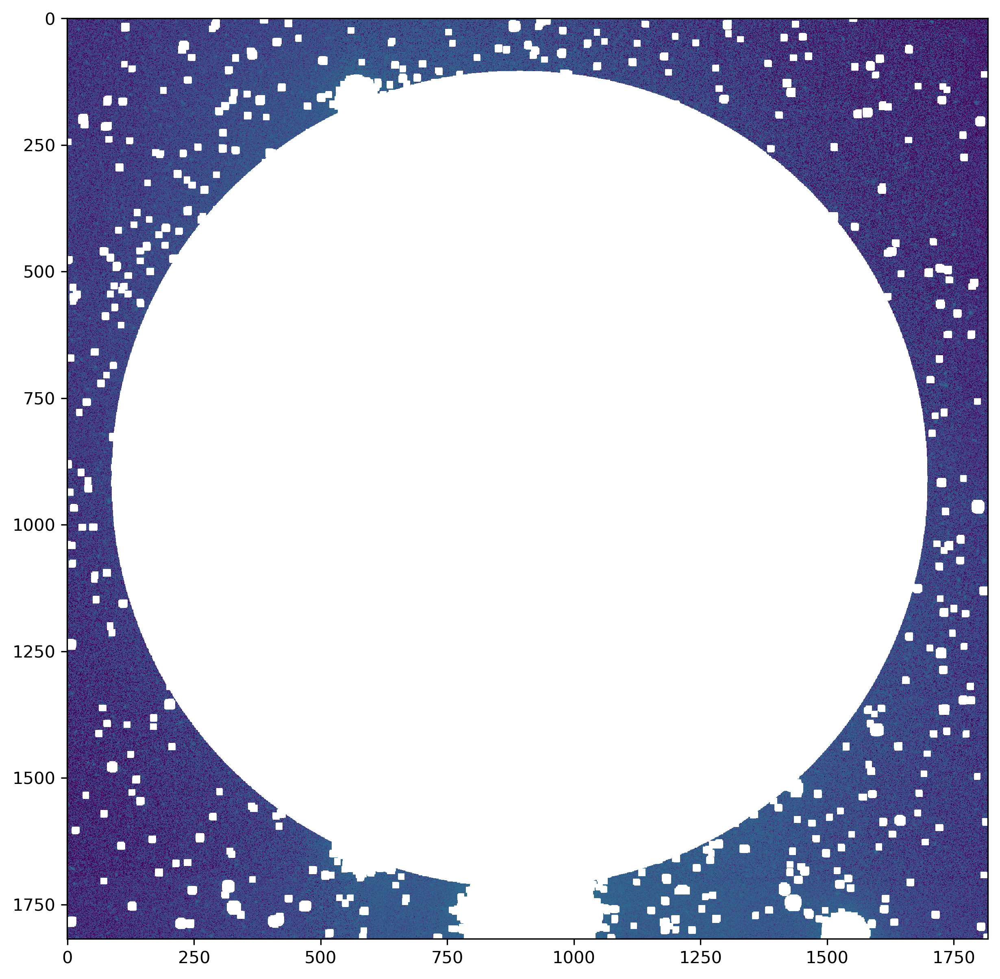

In [168]:
plt.figure(figsize = (10,10), dpi = 300)
plt.imshow(data_m2*10, norm = norm )

In [141]:
bkg = np.median(data_m2.data[~data_m2.mask])

In [107]:
from astropy.stats import sigma_clipped_stats

In [132]:
avg, med, std = sigma_clipped_stats(data_m2.data[~data_m2.mask], sigma=3.0)

In [153]:
bkg

0.010553679

In [133]:
avg

0.010692243

In [134]:
med

0.010539103